It is highly recommended to use a powerful **GPU**, you can use it for free uploading this notebook to [Google Colab](https://colab.research.google.com/notebooks/intro.ipynb).
<table align="center">
 <td align="center"><a target="_blank" href="https://colab.research.google.com/github/ezponda/intro_deep_learning/blob/main/class/CNN/Object_Detection.ipynb">
        <img src="https://colab.research.google.com/img/colab_favicon_256px.png"  width="50" height="50" style="padding-bottom:5px;" />Run in Google Colab</a></td>
  <td align="center"><a target="_blank" href="https://github.com/ezponda/intro_deep_learning/blob/main/class/CNN/Object_Detection.ipynb">
        <img src="https://github.githubassets.com/images/modules/logos_page/GitHub-Mark.png"  width="50" height="50" style="padding-bottom:5px;" />View Source on GitHub</a></td>
</table>

### TensorFlow Hub

[TensorFlow Hub](https://www.tensorflow.org/hub) is a repository of trained machine learning models. You can install it with: 
```python
!pip install --upgrade tensorflow_hub
```


In [ ]:
#!pip install --upgrade tensorflow_hub
#!pip install opencv-python
#!pip install opencv-python-headless

In [1]:
import tensorflow as tf
import tensorflow_hub as hub
from PIL import Image, ImageDraw
from IPython.display import Image as IPyImage
import numpy as np
import time
import cv2

We can find multiple [models](https://tfhub.dev/tensorflow/collections/object_detection/1) in [Tensorflow-Hub](https://www.tensorflow.org/hub), and [here](https://tfhub.dev/s?module-type=image-object-detection) you can find all the models.

In [2]:
ALL_MODELS = {
    'CenterNet HourGlass104 512x512':
    'https://tfhub.dev/tensorflow/centernet/hourglass_512x512/1',
    'CenterNet HourGlass104 Keypoints 512x512':
    'https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1',
    'CenterNet HourGlass104 1024x1024':
    'https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024/1',
    'CenterNet HourGlass104 Keypoints 1024x1024':
    'https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1',
    'CenterNet Resnet50 V1 FPN 512x512':
    'https://tfhub.dev/tensorflow/centernet/resnet50v1_fpn_512x512/1',
    'CenterNet Resnet50 V1 FPN Keypoints 512x512':
    'https://tfhub.dev/tensorflow/centernet/resnet50v1_fpn_512x512_kpts/1',
    'CenterNet Resnet101 V1 FPN 512x512':
    'https://tfhub.dev/tensorflow/centernet/resnet101v1_fpn_512x512/1',
    'CenterNet Resnet50 V2 512x512':
    'https://tfhub.dev/tensorflow/centernet/resnet50v2_512x512/1',
    'CenterNet Resnet50 V2 Keypoints 512x512':
    'https://tfhub.dev/tensorflow/centernet/resnet50v2_512x512_kpts/1',
    'EfficientDet D0 512x512':
    'https://tfhub.dev/tensorflow/efficientdet/d0/1',
    'EfficientDet D1 640x640':
    'https://tfhub.dev/tensorflow/efficientdet/d1/1',
    'EfficientDet D2 768x768':
    'https://tfhub.dev/tensorflow/efficientdet/d2/1',
    'EfficientDet D3 896x896':
    'https://tfhub.dev/tensorflow/efficientdet/d3/1',
    'EfficientDet D4 1024x1024':
    'https://tfhub.dev/tensorflow/efficientdet/d4/1',
    'EfficientDet D5 1280x1280':
    'https://tfhub.dev/tensorflow/efficientdet/d5/1',
    'EfficientDet D6 1280x1280':
    'https://tfhub.dev/tensorflow/efficientdet/d6/1',
    'EfficientDet D7 1536x1536':
    'https://tfhub.dev/tensorflow/efficientdet/d7/1',
    'SSD MobileNet v2 320x320':
    'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/2',
    'SSD MobileNet V1 FPN 640x640':
    'https://tfhub.dev/tensorflow/ssd_mobilenet_v1/fpn_640x640/1',
    'SSD MobileNet V2 FPNLite 320x320':
    'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/fpnlite_320x320/1',
    'SSD MobileNet V2 FPNLite 640x640':
    'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/fpnlite_640x640/1',
    'SSD ResNet50 V1 FPN 640x640 (RetinaNet50)':
    'https://tfhub.dev/tensorflow/retinanet/resnet50_v1_fpn_640x640/1',
    'SSD ResNet50 V1 FPN 1024x1024 (RetinaNet50)':
    'https://tfhub.dev/tensorflow/retinanet/resnet50_v1_fpn_1024x1024/1',
    'SSD ResNet101 V1 FPN 640x640 (RetinaNet101)':
    'https://tfhub.dev/tensorflow/retinanet/resnet101_v1_fpn_640x640/1',
    'SSD ResNet101 V1 FPN 1024x1024 (RetinaNet101)':
    'https://tfhub.dev/tensorflow/retinanet/resnet101_v1_fpn_1024x1024/1',
    'SSD ResNet152 V1 FPN 640x640 (RetinaNet152)':
    'https://tfhub.dev/tensorflow/retinanet/resnet152_v1_fpn_640x640/1',
    'SSD ResNet152 V1 FPN 1024x1024 (RetinaNet152)':
    'https://tfhub.dev/tensorflow/retinanet/resnet152_v1_fpn_1024x1024/1',
    'Faster R-CNN ResNet50 V1 640x640':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_640x640/1',
    'Faster R-CNN ResNet50 V1 1024x1024':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_1024x1024/1',
    'Faster R-CNN ResNet50 V1 800x1333':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_800x1333/1',
    'Faster R-CNN ResNet101 V1 640x640':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_640x640/1',
    'Faster R-CNN ResNet101 V1 1024x1024':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_1024x1024/1',
    'Faster R-CNN ResNet101 V1 800x1333':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_800x1333/1',
    'Faster R-CNN ResNet152 V1 640x640':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_640x640/1',
    'Faster R-CNN ResNet152 V1 1024x1024':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_1024x1024/1',
    'Faster R-CNN ResNet152 V1 800x1333':
    'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_800x1333/1',
    'Faster R-CNN Inception ResNet V2 640x640':
    'https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_640x640/1',
    'Faster R-CNN Inception ResNet V2 1024x1024':
    'https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_1024x1024/1',
    'Mask R-CNN Inception ResNet V2 1024x1024':
    'https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1'
}

## total clases
classes = {1: 'person', 2: 'bicycle', 3: 'car', 4: 'motorcycle', 5: 'airplane', 6: 'bus', 7: 'train', 8: 'truck', 9: 'boat', 10: 'traffic light', 11: 'fire hydrant', 13: 'stop sign', 14: 'parking meter', 15: 'bench', 16: 'bird', 17: 'cat', 18: 'dog', 19: 'horse', 20: 'sheep', 21: 'cow', 22: 'elephant', 23: 'bear', 24: 'zebra', 25: 'giraffe', 27: 'backpack', 28: 'umbrella', 31: 'handbag', 32: 'tie', 33: 'suitcase', 34: 'frisbee', 35: 'skis', 36: 'snowboard', 37: 'sports ball', 38: 'kite', 39: 'baseball bat', 40: 'baseball glove', 41: 'skateboard', 42: 'surfboard', 43: 'tennis racket', 44: 'bottle', 46: 'wine glass', 47: 'cup', 48: 'fork', 49: 'knife', 50: 'spoon', 51: 'bowl', 52: 'banana', 53: 'apple', 54: 'sandwich', 55: 'orange', 56: 'broccoli', 57: 'carrot', 58: 'hot dog', 59: 'pizza', 60: 'donut', 61: 'cake', 62: 'chair', 63: 'couch', 64: 'potted plant', 65: 'bed', 67: 'dining table', 70: 'toilet', 72: 'tv', 73: 'laptop', 74: 'mouse', 75: 'remote', 76: 'keyboard', 77: 'cell phone', 78: 'microwave', 79: 'oven', 80: 'toaster', 81: 'sink', 82: 'refrigerator', 84: 'book', 85: 'clock', 86: 'vase', 87: 'scissors', 88: 'teddy bear', 89: 'hair drier', 90: 'toothbrush'}

In [3]:
model_name = 'SSD MobileNet V2 FPNLite 320x320' # 'SSD MobileNet v2 320x320' #  ['CenterNet HourGlass104 512x512','CenterNet HourGlass104 Keypoints 512x512','CenterNet HourGlass104 1024x1024','CenterNet HourGlass104 Keypoints 1024x1024','CenterNet Resnet50 V1 FPN 512x512','CenterNet Resnet50 V1 FPN Keypoints 512x512','CenterNet Resnet101 V1 FPN 512x512','CenterNet Resnet50 V2 512x512','CenterNet Resnet50 V2 Keypoints 512x512','EfficientDet D0 512x512','EfficientDet D1 640x640','EfficientDet D2 768x768','EfficientDet D3 896x896','EfficientDet D4 1024x1024','EfficientDet D5 1280x1280','EfficientDet D6 1280x1280','EfficientDet D7 1536x1536','SSD MobileNet v2 320x320','SSD MobileNet V1 FPN 640x640','SSD MobileNet V2 FPNLite 320x320','SSD MobileNet V2 FPNLite 640x640','SSD ResNet50 V1 FPN 640x640 (RetinaNet50)','SSD ResNet50 V1 FPN 1024x1024 (RetinaNet50)','SSD ResNet101 V1 FPN 640x640 (RetinaNet101)','SSD ResNet101 V1 FPN 1024x1024 (RetinaNet101)','SSD ResNet152 V1 FPN 640x640 (RetinaNet152)','SSD ResNet152 V1 FPN 1024x1024 (RetinaNet152)','Faster R-CNN ResNet50 V1 640x640','Faster R-CNN ResNet50 V1 1024x1024','Faster R-CNN ResNet50 V1 800x1333','Faster R-CNN ResNet101 V1 640x640','Faster R-CNN ResNet101 V1 1024x1024','Faster R-CNN ResNet101 V1 800x1333','Faster R-CNN ResNet152 V1 640x640','Faster R-CNN ResNet152 V1 1024x1024','Faster R-CNN ResNet152 V1 800x1333','Faster R-CNN Inception ResNet V2 640x640','Faster R-CNN Inception ResNet V2 1024x1024','Mask R-CNN Inception ResNet V2 1024x1024']
model_handle = ALL_MODELS[model_name]
print('Selected model:'+ model_name)
print('Model Handle at TensorFlow Hub: {}'.format(model_handle))
detector = hub.load(model_handle)
print('Model loaded')

Selected model:SSD MobileNet V2 FPNLite 320x320
Model Handle at TensorFlow Hub: https://tfhub.dev/tensorflow/ssd_mobilenet_v2/fpnlite_320x320/1
Model loaded


### Utilities

Functions included in the [object-detection API](https://www.tensorflow.org/hub/tutorials/object_detection)

In [4]:
# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

# For measuring the inference time.
import time


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
    """Adds a bounding box to an image."""
    draw = ImageDraw.Draw(image)
    im_width, im_height = image.size
    (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                  ymin * im_height, ymax * im_height)
    draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
               (left, top)],
              width=thickness,
              fill=color)

    # If the total height of the display strings added to the top of the bounding
    # box exceeds the top of the image, stack the strings below the bounding box
    # instead of above.
    display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
    # Each display_str has a top and bottom margin of 0.05x.
    total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

    if top > total_display_str_height:
        text_bottom = top
    else:
        text_bottom = top + total_display_str_height
    # Reverse list and print from bottom to top.
    for display_str in display_str_list[::-1]:
        text_width, text_height = font.getsize(display_str)
        margin = np.ceil(0.05 * text_height)
        draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                        (left + text_width, text_bottom)],
                       fill=color)
        draw.text((left + margin, text_bottom - text_height - margin),
                  display_str,
                  fill="black",
                  font=font)
        text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.45):
    """Overlay labeled boxes on an image with formatted scores and label names."""
    colors = list(ImageColor.colormap.values())

    try:
        font = ImageFont.truetype(
            "/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
            25)
    except IOError:
        #print("Font not found, using default font.")
        font = ImageFont.load_default()

    for i in range(min(boxes.shape[0], max_boxes)):
        if scores[i] >= min_score:
            ymin, xmin, ymax, xmax = tuple(boxes[i])
            if not(i < len(class_names) and i < len(scores)):
                continue
            display_str = "{}: {}%".format(class_names[i],
                                           int(100 * scores[i]))
            color = colors[hash(class_names[i]) % len(colors)]
            image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
            draw_bounding_box_on_image(image_pil,
                                       ymin,
                                       xmin,
                                       ymax,
                                       xmax,
                                       color,
                                       font,
                                       display_str_list=[display_str])
            np.copyto(image, np.array(image_pil))
    return image

## Single Image Object Detection

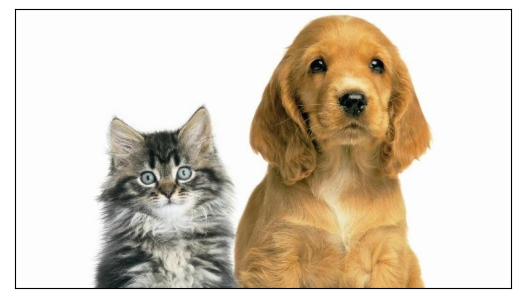

In [5]:
## Detect one image
from matplotlib import pyplot as plt
import numpy as np
def read_image(image_path, target_size=None):
    image = tf.keras.preprocessing.image.load_img(image_path,
                target_size=target_size)
    image = tf.keras.preprocessing.image.img_to_array(image)
    image = image.astype(np.uint8)
    return image

url = 'https://akm-img-a-in.tosshub.com/indiatoday/images/story/201812/dogs_and_cats.jpeg?TAxD19DTCFE7WiSYLUdTu446cfW4AbuW&size=770:433'
image_path = tf.keras.utils.get_file("dog-cat2.jpg", url)
image = read_image(image_path)
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.show()

In [6]:
converted_img = np.expand_dims(image, 0)
t = time.time()
result = detector(converted_img)
print("Inference time: ", time.time() - t)
result.keys()

Inference time:  3.6799356937408447


dict_keys(['raw_detection_boxes', 'detection_multiclass_scores', 'detection_classes', 'detection_boxes', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])

In [7]:
result['detection_scores']

<tf.Tensor: shape=(1, 100), dtype=float32, numpy=
array([[0.7183873 , 0.6502964 , 0.23219188, 0.19856475, 0.18700764,
        0.18103032, 0.1739132 , 0.1668429 , 0.13398845, 0.12446486,
        0.12240829, 0.12120502, 0.12067304, 0.11340254, 0.11213185,
        0.10631898, 0.09785563, 0.09781854, 0.09696194, 0.09188258,
        0.09175564, 0.08844665, 0.08664116, 0.08347624, 0.08281261,
        0.07965121, 0.07576305, 0.07449189, 0.06508945, 0.06202235,
        0.06162331, 0.05931193, 0.05727877, 0.05712631, 0.0568222 ,
        0.05659073, 0.05603065, 0.0554852 , 0.05544672, 0.05503582,
        0.05352613, 0.05170448, 0.0507872 , 0.04921406, 0.04915242,
        0.04823057, 0.04727299, 0.04672959, 0.046515  , 0.04599046,
        0.04538533, 0.04524478, 0.04515114, 0.04424301, 0.04337866,
        0.0432281 , 0.04284104, 0.04270966, 0.042557  , 0.04226776,
        0.04185689, 0.04164744, 0.04121689, 0.04064752, 0.04045035,
        0.03995787, 0.03887502, 0.03861641, 0.03831884, 0.03812989

In [8]:
def run_detector(detector, image, classes):

    converted_img = np.expand_dims(image, 0)

    start_time = time.time()
    result = detector(converted_img)
    end_time = time.time()

    result = {key: value.numpy() for key, value in result.items()}
    print("Inference time: ", end_time - start_time)

    classes_names = [classes[i]
                     for i in result["detection_classes"][0] if i in classes]

    detection_boxes = result["detection_boxes"][0]
    detection_scores = result["detection_scores"][0]
    image_with_boxes = draw_boxes(image, detection_boxes,
                                  classes_names, detection_scores)

    return image_with_boxes


image_with_boxes = run_detector(detector, image, classes)

Inference time:  0.09656882286071777


C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:45: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


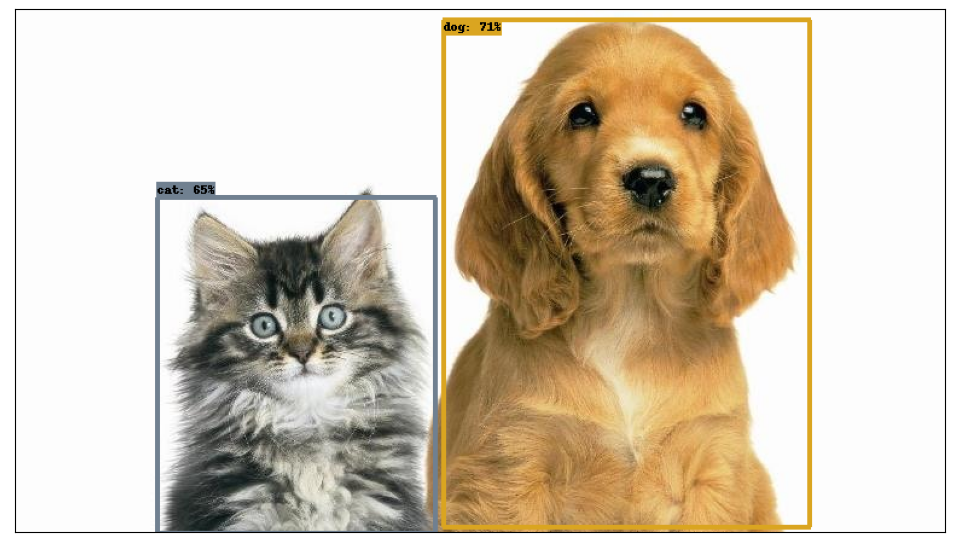

In [9]:
plt.figure(figsize=(12, 12))
plt.imshow(image_with_boxes)
plt.xticks([])
plt.yticks([])
plt.show()

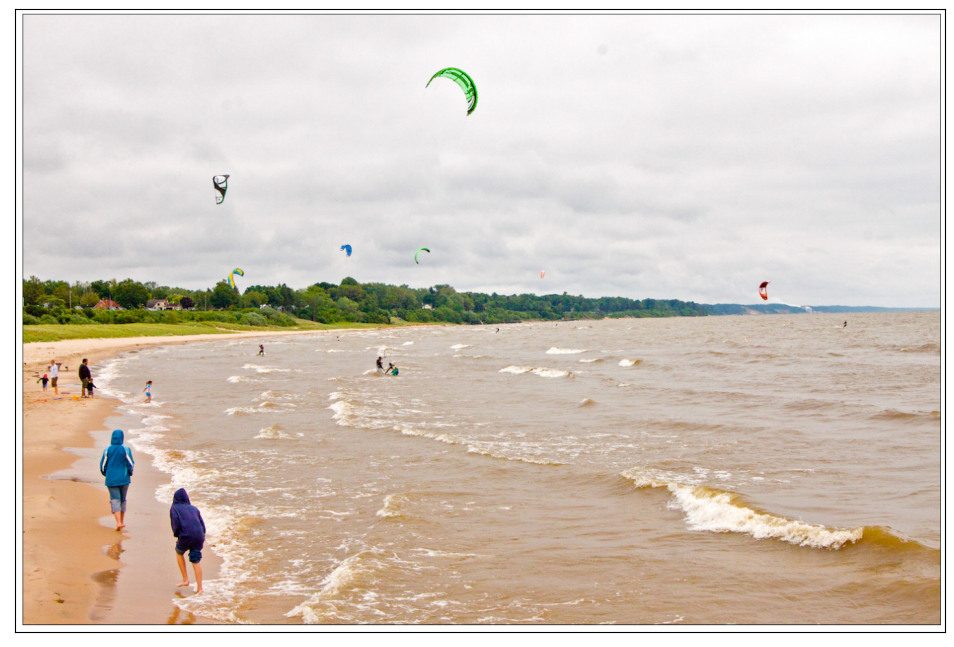

In [10]:
url = 'https://i.ibb.co/R7pRTLy/beach-no-axis.png'
image_path = tf.keras.utils.get_file("beach2.jpg", url)
image = read_image(image_path)
plt.figure(figsize=(12, 12))
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.show()

Inference time:  0.09032154083251953


C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:45: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


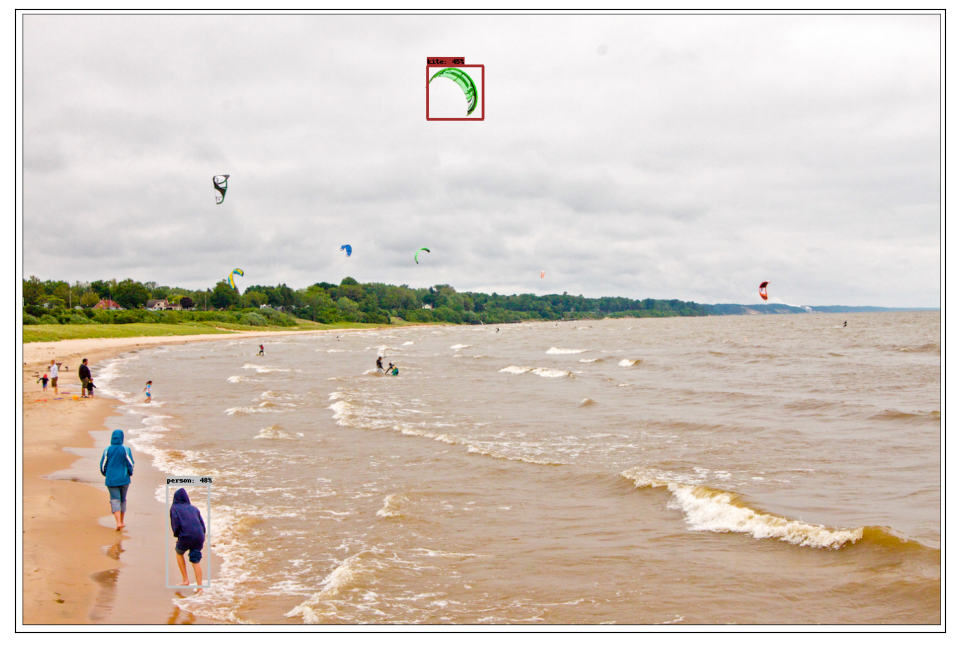

In [11]:
image_with_boxes = run_detector(detector, image, classes)
plt.figure(figsize=(12, 12))
plt.imshow(image_with_boxes)
plt.xticks([])
plt.yticks([])
plt.show()

1683370/1683370 [==============================] - 0s 0us/step


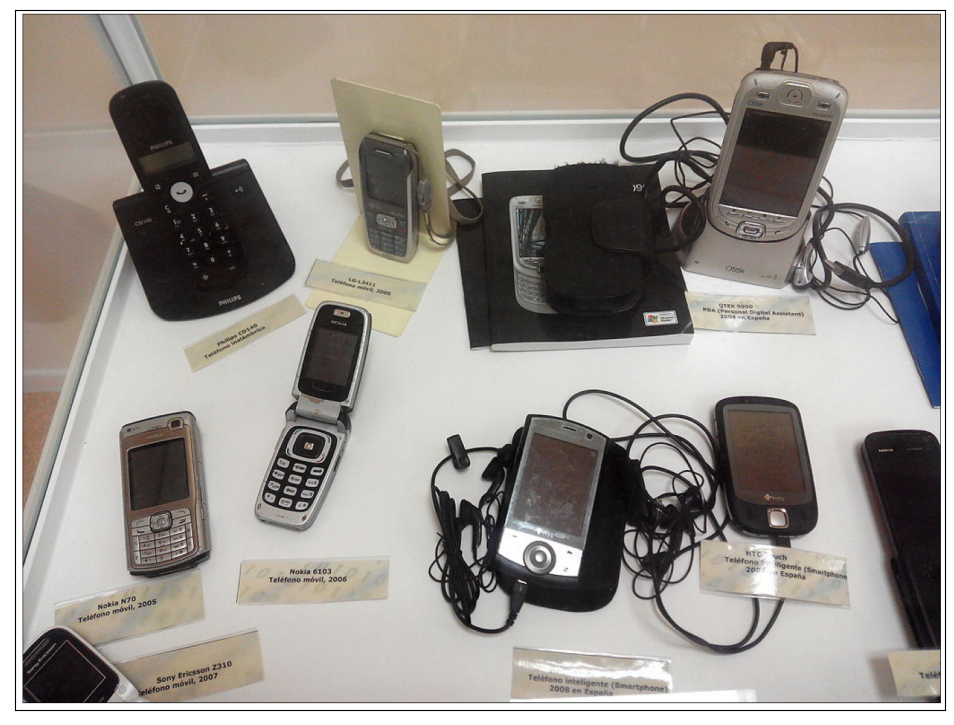

Inference time:  0.09968066215515137


C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:45: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


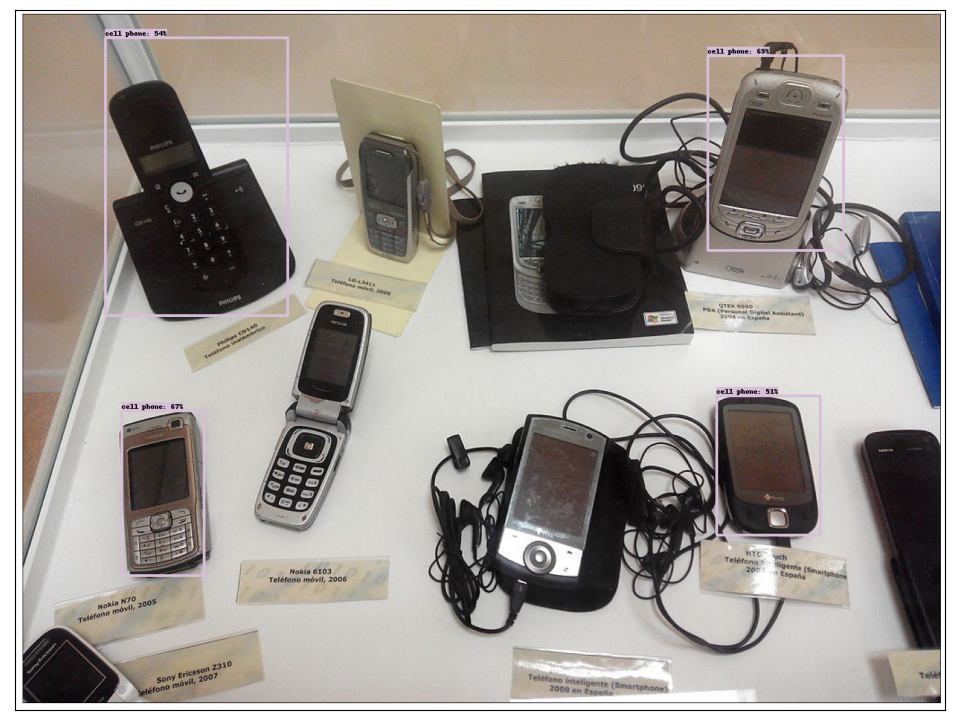

In [12]:
url = 'https://i.ibb.co/jL1kZRF/phones.png'
image_path = tf.keras.utils.get_file("phones.jpg", url)
image = read_image(image_path)
plt.figure(figsize=(12, 12))
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.show()

image_with_boxes = run_detector(detector, image, classes)
plt.figure(figsize=(12, 12))
plt.imshow(image_with_boxes)
plt.xticks([])
plt.yticks([])
plt.show()

## Object detection with OpenCV, YOLO

YOLO is a real-time object detection algorithm that is known for its speed and accuracy. Unlike other object detection algorithms that use a sliding window approach, YOLO divides the input image into an SxS grid and generates bounding boxes and class probabilities directly from the grid cells. This allows YOLO to process images in a single forward pass through the network, making it extremely fast and suitable for real-time applications.

### Download the latest YOLO weights, configuration, and class names:

Save these files from [AlexeyAB](https://github.com/AlexeyAB/darknet) in the same directory as your Jupyter Notebook.

- [yolov4.weights](https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights)
- [yolov4.cfg](https://github.com/AlexeyAB/darknet/blob/master/cfg/yolov4.cfg)
- [coco.names](https://github.com/AlexeyAB/darknet/blob/master/data/coco.names)

or in shell:

```shell
!wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights
!wget https://raw.githubusercontent.com/AlexeyAB/darknet/master/cfg/yolov4.cfg
!wget https://raw.githubusercontent.com/AlexeyAB/darknet/master/data/coco.names

```

In [ ]:
def load_yolo_model():
    # Load YOLO model configuration and weights
    net = cv2.dnn.readNet("yolov4.weights", "yolov4.cfg")

    # Load COCO dataset classes
    with open("coco.names", "r") as f:
        classes = [line.strip() for line in f.readlines()]

    return net, classes


def detect_objects(img, net):
    blob = cv2.dnn.blobFromImage(img, 1/255, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]
    outputs = net.forward(output_layers)
    return outputs

# Load the YOLO model
net, classes = load_yolo_model()
print(f'classes: {classes}')

In [ ]:
def draw_boxes(img, detections, classes):
    height, width, channels = img.shape
    class_ids = []
    confidences = []
    boxes = []

    for output in detections:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    for i in indices:
        i = i[0]
        x, y, w, h = boxes[i]
        label = str(classes[class_ids[i]])
        color = np.random.randint(0, 255, 3).tolist()
        cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
        cv2.putText(img, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    return img

In [ ]:
import urllib.request
from urllib.error import HTTPError, URLError
import matplotlib.pyplot as plt

def read_image_from_url(url):
    try:
        with urllib.request.urlopen(url) as url_response:
            image_array = np.asarray(bytearray(url_response.read()), dtype=np.uint8)
            image = cv2.imdecode(image_array, -1)

        # Convert the image from BGR to RGB (used by matplotlib)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        return image_rgb
    except (HTTPError, URLError) as e:
        print(f"Error: {e}")
        return None


In [ ]:
url = 'https://i.ibb.co/jL1kZRF/phones.png'
image = read_image_from_url(url)
plt.figure(figsize=(12, 12))
plt.imshow(image)
plt.xticks([])
plt.yticks([])
plt.show()

detections = detect_objects(image, net)
image_with_boxes = draw_boxes(image, detections, classes)
plt.figure(figsize=(12, 12))
plt.imshow(image_with_boxes)
plt.xticks([])
plt.yticks([])
plt.show()

In [ ]:
cap = cv2.VideoCapture(0)
time.sleep(1)  ### letting the camera autofocus

In [ ]:

axes = None
NUM_FRAMES = 40  # you can change this
processed_imgs = []
for i in range(NUM_FRAMES):
    # Load frame from the camera
    ret, frame = cap.read()
    detections = detect_objects(frame, net)
    image_boxes = draw_boxes(frame, detections, classes)

    img = Image.fromarray(np.uint8(image_boxes))#.convert('RGB')
    processed_imgs.append(img)
    cv2.imshow("test", cv2.cvtColor(image_boxes, cv2.COLOR_BGR2RGB))
    cv2.waitKey(1)

In [ ]:
cap.release()
cv2.destroyAllWindows()

In [ ]:
## create gif
processed_imgs[0].save('web_cam.gif',
                       format='GIF',
                       append_images=processed_imgs[1:],
                       save_all=True,
                       duration=100,
                       loop=0)

In [ ]:
IPyImage('web_cam.gif', format='png', width=15 * 40, height=3 * 40) 

### Web cam Local
#### Detection loop
The detection loop consists of four phases:

- loading the webcam frame

- pre-processing the image

- running the image through the network

- updating the output with the resulting predictions

In [13]:
import cv2
# Load the webcam handler
cap = cv2.VideoCapture(0)
time.sleep(1)  ### letting the camera autofocus

In [22]:
cap = cv2.VideoCapture(0)
time.sleep(1)  ### letting the camera autofocus

axes = None
NUM_FRAMES = 100  # you can change this
processed_imgs = []
for i in range(NUM_FRAMES):
    # Load frame from the camera
    ret, frame = cap.read()
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    image_boxes = run_detector(detector, frame, classes)
    img = Image.fromarray(np.uint8(image_boxes))#.convert('RGB')
    processed_imgs.append(img)
    cv2.imshow("test", cv2.cvtColor(image_boxes, cv2.COLOR_BGR2RGB))
    cv2.waitKey(1)

Inference time:  0.08529901504516602
Inference time:  0.0841372013092041


C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:45: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


Inference time:  0.08942270278930664
Inference time:  0.09604549407958984
Inference time:  0.08867955207824707
Inference time:  0.08418726921081543
Inference time:  0.09252142906188965
Inference time:  0.08224821090698242
Inference time:  0.08719158172607422
Inference time:  0.07996058464050293
Inference time:  0.08349823951721191
Inference time:  0.09736514091491699
Inference time:  0.09754800796508789
Inference time:  0.08098959922790527
Inference time:  0.0949711799621582
Inference time:  0.07926678657531738
Inference time:  0.06998205184936523
Inference time:  0.08251285552978516
Inference time:  0.08321428298950195
Inference time:  0.09503793716430664
Inference time:  0.0874326229095459
Inference time:  0.08110499382019043
Inference time:  0.09284043312072754
Inference time:  0.08018708229064941
Inference time:  0.09247684478759766
Inference time:  0.1032869815826416
Inference time:  0.11537289619445801
Inference time:  0.10750651359558105
Inference time:  0.09513211250305176
Infe

In [23]:
cap.release()
cv2.destroyAllWindows()

In [36]:
## create gif
processed_imgs[0].save('web_cam.gif',
                       format='GIF',
                       append_images=processed_imgs[1:],
                       save_all=True,
                       duration=100,
                       loop=0)

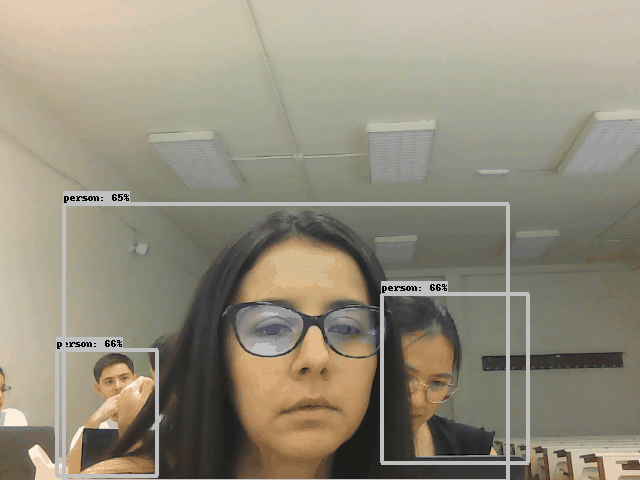

In [37]:
IPyImage('web_cam.gif', format='png', width=15 * 40, height=3 * 40) 

## Web cam Colab

In [ ]:
'''
## Camera Capture
Using a webcam to capture images for processing on the runtime.
Source: https://colab.research.google.com/notebooks/snippets/advanced_outputs.ipynb#scrollTo=2viqYx97hPMi
'''

from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      // show the video in the HTML element
      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // prints the logs to cell
      let jsLog = function(abc) {
        document.querySelector("#output-area").appendChild(document.createTextNode(`${abc}... `));
      }

      // Wait for Capture to be clicked.
      // await new Promise((resolve) => capture.onclick = resolve);

      for (let i = 0; i < 5; i++) {
        const canvas = document.createElement('canvas');
        canvas.width = video.videoWidth;
        canvas.height = video.videoHeight;
        canvas.getContext('2d').drawImage(video, 0, 0);
        img = canvas.toDataURL('image/jpeg', quality);

        // show each captured image
        // let imgTag = document.createElement('img');
        // imgTag.src = img;
        // div.appendChild(imgTag);

        jsLog(i + "sending")
        // Call a python function and send this image
        google.colab.kernel.invokeFunction('notebook.run_algo', [img], {});
        jsLog(i + "SENT")
        // wait for X miliseconds second, before next capture
        await new Promise(resolve => setTimeout(resolve, 250));
      }

      stream.getVideoTracks()[0].stop(); // stop video stream
    }
    ''')
  display(js) # make the provided HTML, part of the cell
  data = eval_js('takePhoto({})'.format(quality)) # call the takePhoto() JavaScript function

In [ ]:
import IPython
from google.colab import output
from google.colab.patches import cv2_imshow

import time
import sys
import numpy as np
import cv2

from PIL import Image
from io import BytesIO
import base64
import logging

def data_uri_to_img(uri):
    """convert base64image to numpy array"""
    try:
        image = base64.b64decode(uri.split(',')[1], validate=True)
        # make the binary image, a PIL image
        image = Image.open(BytesIO(image))
        # convert to numpy array
        image = np.array(image, dtype=np.uint8);
        return image
    except Exception as e:
        logging.exception(e);
        print('\n')
        return None


def run_algo(imgB64):
    """
    in Colab, run_algo function gets invoked by the JavaScript, that sends N images every second
  
    params:
      image: image
    """
    image = data_uri_to_img(imgB64)
    frame = image
    if image is None:
        print("At run_algo(): image is None.")
        return
    try:
        # Run detection
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB).astype('uint8')
        image_boxes = run_detector(detector, frame, classes)
        cv2_imshow(image_boxes)
    except Exception as e:
        logging.exception(e)

# register this function, so JS code could call this
output.register_callback('notebook.run_algo', run_algo)

# put the JS code in cell and run it
take_photo()

## Practice: Traffic Scene  Object Detection

### Scene 1

In [47]:
## load the scene gif
url_1 = 'https://i.ibb.co/wpHvb58/scene1.gif'
scene_1_path = tf.keras.utils.get_file("scene_1.gif", url_1)

In [48]:
IPyImage(scene_1_path, format='png', width=15 * 40, height=3 * 40)
IPyImage(url=url_1)

In [49]:
gif_object = Image.open(scene_1_path)

# Display individual frames from the loaded animated GIF file
processed_imgs = []
for ind in range(0, gif_object.n_frames):
    gif_object.seek(ind)
    ## frame in numpy array format (512, 512, 3)
    frame = np.array(gif_object.convert('RGB'))
    ## Object Detection code
    image_with_boxes = run_detector(detector, frame, classes)
    img1 = Image.fromarray(np.uint8(image_with_boxes))#.convert('RGB')
    processed_imgs.append(img1)

Inference time:  0.2063920497894287


C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
C:\Users\ferli\AppData\Local\Temp\ipykernel_46560\3514942370.py:45: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  text_width, text_height = font.getsize(display_str)


Inference time:  0.20398306846618652
Inference time:  0.20595169067382812
Inference time:  0.21028852462768555
Inference time:  0.2105107307434082
Inference time:  0.19275522232055664
Inference time:  0.20525884628295898
Inference time:  0.2179872989654541
Inference time:  0.18468856811523438
Inference time:  0.18288421630859375
Inference time:  0.18041467666625977
Inference time:  0.18075799942016602
Inference time:  0.17628741264343262
Inference time:  0.1932976245880127
Inference time:  0.1856379508972168
Inference time:  0.1750187873840332
Inference time:  0.17264556884765625
Inference time:  0.19151043891906738
Inference time:  0.19130182266235352
Inference time:  0.1888442039489746
Inference time:  0.1824188232421875
Inference time:  0.18894600868225098
Inference time:  0.18934392929077148
Inference time:  0.1882314682006836
Inference time:  0.19809198379516602
Inference time:  0.19469213485717773
Inference time:  0.19688630104064941
Inference time:  0.20997333526611328
Inference

In [50]:
## save the processed scene gif
processed_imgs[0].save('scene1_boxes.gif',
                       format='GIF',
                       append_images=processed_imgs[1:],
                       save_all=True,
                       duration=200,
                       loop=0)

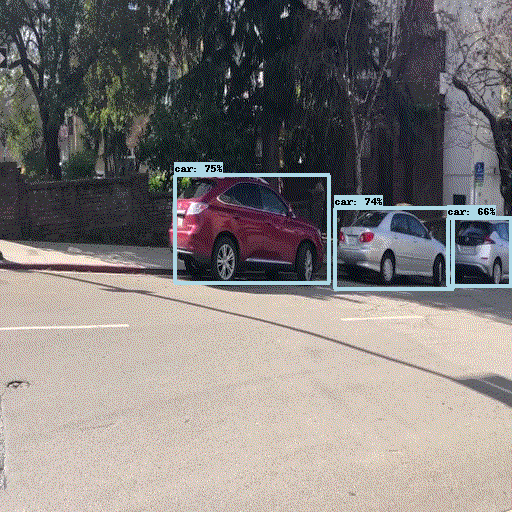

In [51]:
IPyImage('scene1_boxes.gif', format='png', width=15 * 40, height=3 * 40) 

In [ ]:
# Download from colab
#from google.colab import files
#files.download('scene1_boxes.gif') 

### Scene 2

In [ ]:
## load the scene gif
url_2 = 'https://i.ibb.co/wpHvb58/scene2.gif'
scene_2_path = tf.keras.utils.get_file("scene_2.gif", url_1)

In [ ]:
#IPyImage(scene_2_path, format='png', width=15 * 40, height=3 * 40)
#IPyImage(url=url_2)

In [ ]:
gif_object = Image.open(scene_2_path)

# Display individual frames from the loaded animated GIF file
processed_imgs = []
for ind in range(0, gif_object.n_frames):
    gif_object.seek(ind)
    ## frame in numpy array format (512, 512, 3)
    frame = np.array(gif_object.convert('RGB'))
    ## Object Detection code

    ##
    processed_imgs.append(...)

In [ ]:
## save the processed scene gif
processed_imgs[0].save('scene2_boxes.gif',
                       format='GIF',
                       append_images=processed_imgs[1:],
                       save_all=True,
                       duration=200,
                       loop=0)

In [ ]:
IPyImage('scene2_boxes.gif', format='png', width=15 * 40, height=3 * 40)

In [ ]:
# Download from colab
#from google.colab import files
#files.download('scene1_boxes.gif')